In [1]:
# Common
import os  # Importing the operating system module for interacting with the file system
import keras  # Importing the Keras deep learning library
import datetime  # Importing the datetime module for handling date and time
import numpy as np  # Importing NumPy for numerical operations
from tqdm import tqdm  # Importing tqdm for creating progress bars
from glob import glob  # Importing glob for file path pattern matching
import tensorflow as tf  # Importing TensorFlow, a popular deep learning library
import tensorflow.image as tfi  # Importing the image module from TensorFlow for image processing

# Data
from keras.preprocessing.image import load_img, img_to_array  # Importing functions for loading and converting images

# Data Viz
import matplotlib.pyplot as plt  # Importing Matplotlib for data visualization

# Model
from keras.layers import ReLU  # Importing the ReLU activation function
from keras.layers import Layer  # Importing the Layer base class for custom layers
from keras.layers import Input  # Importing the Input layer for defining model inputs
from keras.layers import Conv2D  # Importing the Conv2D layer for 2D convolution
from keras.layers import Dropout  # Importing the Dropout layer for regularization
from keras.layers import MaxPool2D  # Importing the MaxPooling2D layer for max pooling
from keras.layers import LeakyReLU  # Importing the Leaky ReLU activation function
from keras.layers import concatenate  # Importing the concatenate layer for merging layers
from keras.layers import ZeroPadding2D  # Importing the ZeroPadding2D layer for zero-padding
from keras.layers import Conv2DTranspose  # Importing the Conv2DTranspose layer for transposed convolution
from keras.initializers import RandomNormal  # Importing the RandomNormal initializer
from keras.layers import BatchNormalization  # Importing the BatchNormalization layer for normalizing activations
from tensorflow.keras.optimizers import Adam  # Importing the Adam optimizer
from keras.models import Sequential, Model, load_model  # Importing model-related components

# Model Viz
from tensorflow.keras.utils import plot_model  # Importing a function for plotting the model architecture

# Model Losses
from keras.losses import BinaryCrossentropy  # Importing the binary cross-entropy loss
from keras.losses import MeanAbsoluteError  # Importing the mean absolute error loss


/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
def load_data(path, trim=1000):
    # Get a list of paths for color images and limit the number using the trim parameter
    color_paths = sorted(glob(path + "*.jpg"))[:trim]
    
    # Initialize an empty list to store paths for corresponding grayscale images
    gray_paths = []
    
    # Create paths for grayscale images by replacing 'color/' with 'gray/' in each color image path
    for path in color_paths:
        gray_paths.append(path.replace('color/', 'gray/'))
    
    # Initialize arrays to store color and grayscale images with shape (num_images, 256, 256, 3)
    images = np.zeros(shape=(len(color_paths), 256, 256, 3))
    masks = np.zeros(shape=(len(gray_paths), 256, 256, 3))
    
    # Initialize a counter variable
    i = 0
    
    # Loop through pairs of color and grayscale paths, loading and processing images
    for color_path, gray_path in tqdm(zip(color_paths, gray_paths), desc="Data"):
        # Load color image, cast to float32, and store in the 'images' array
        image = tf.cast(img_to_array(load_img(color_path)), tf.float32)
        images[i] = (tfi.resize(image, (256, 256))) / 255.
        
        # Load grayscale image, cast to float32, and store in the 'masks' array
        mask = tf.cast(img_to_array(load_img(gray_path)), tf.float32)
        masks[i] = (tfi.resize(mask, (256, 256))) / 255.

        # Increment the counter
        i += 1
    
    # Return the loaded and processed color and grayscale images
    return images, masks


In [3]:
# Define the path to the color images directory
path = '../input/landscape-image-colorization/landscape Images/color/'

# Call the load_data function to load and preprocess color and grayscale images
color_images, gray_images = load_data(path)


Data: 1000it [00:31, 31.84it/s]


In [4]:
def show_image(image, title=None, alpha=1.0):
    # Display the image using Matplotlib
    plt.imshow(image, alpha=alpha)
    
    # Set the title if provided
    if title is not None:
        plt.title(title)
    
    # Turn off axis labels
    plt.axis('off')


he function is used to display an image using Matplotlib. It takes an image, an optional title, and an alpha value for transparency as parameters. The axis labels are turned off to provide a cleaner visualization.

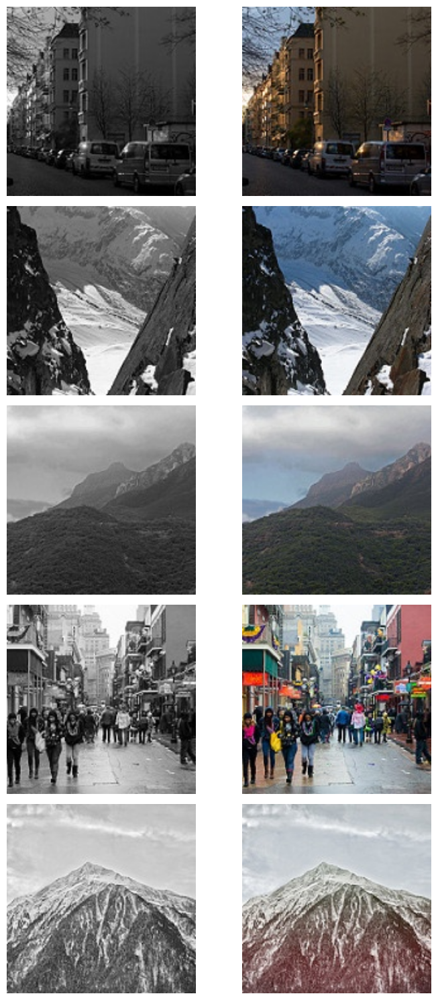

In [5]:
# Create a figure with a specified size
plt.figure(figsize=(8, 15))

# Initialize a counter variable
n = 0

# Loop through 10 iterations to display 5 pairs of color and grayscale images
for i in range(10):
    # Create subplots in a 5x2 grid
    plt.subplot(5, 2, i + 1)
    
    # Alternate between displaying grayscale and color images
    if n == 0:
        # Display grayscale image
        color, gray = color_images[i], gray_images[i]
        show_image(gray)
        n += 1
    elif n == 1:
        # Display color image
        show_image(color)
        n = 0

# Adjust layout for better visualization
plt.tight_layout()

# Show the plot
plt.show()


creating a figure, looping through 10 iterations to display 5 pairs of color and grayscale images in a 5x2 grid. The show_image function is used to display the images, and the counter variable n is used to alternate between displaying grayscale and color images. The layout is adjusted for better visualization, and the plot is shown.

In [6]:
def downsample(filters, apply_batchnorm=True):
    # Create a sequential model for downsampling
    model = Sequential(
        # Convolutional layer with specified filters, kernel size, strides, and padding
        Conv2D(filters, kernel_size=4, strides=2, padding='same', kernel_initializer='he_normal', use_bias=False),
    )

    # Optionally apply batch normalization
    if apply_batchnorm:
        model.add(BatchNormalization())
    
    # Apply Leaky ReLU activation function
    model.add(LeakyReLU(alpha=0.2))

    return model


the function creates a sequential model for downsampling. It consists of a convolutional layer with specified parameters, followed by optional batch normalization and a Leaky ReLU activation function. The function returns the constructed model.

In [7]:
def upsample(filters, apply_dropout=False):
    # Create a sequential model for upsampling
    model = Sequential()

    # Convolutional transpose layer with specified filters, kernel size, strides, and padding
    model.add(Conv2DTranspose(
        filters,
        kernel_size=4,
        strides=2,
        padding='same',
        kernel_initializer='he_normal',
        use_bias=False))
    
    # Batch normalization layer
    model.add(BatchNormalization())
    
    # Optionally apply dropout for regularization
    if apply_dropout:
        model.add(Dropout(0.5))
    
    # ReLU activation function
    model.add(ReLU())

    return model


 the function creates a sequential model for upsampling. It consists of a convolutional transpose layer with specified parameters, followed by batch normalization, optional dropout for regularization, and a ReLU activation function. The function returns the constructed model.

In [8]:
def Generator():
    # Define input layer with shape (256, 256, 3)
    inputs = Input(shape=(256, 256, 3), name="InputLayer")

    # Define a stack of downsampling layers
    down_stack = [
        downsample(64, apply_batchnorm=False),
        downsample(128),
        downsample(256),
        downsample(512),
        downsample(512),
        downsample(512),
        downsample(512),
    ]

    # Apply the encoding layer with downsampling
    encoding = downsample(512)

    # Define a stack of upsampling layers
    up_stack = [
        upsample(512, apply_dropout=True),
        upsample(512, apply_dropout=True),
        upsample(512, apply_dropout=True),
        upsample(512),
        upsample(256),
        upsample(128),
        upsample(64),
    ]

    # Start with the input layer
    x = inputs
    skips = []

    # Apply the downsampling layers and store skip connections
    for down in down_stack:
        x = down(x)
        skips.append(x)

    # Apply the encoding layer
    x = encoding(x)

    # Reverse the skip connections
    skips = reversed(skips)

    # Apply the upsampling layers and concatenate skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = concatenate([x, skip])

    # Initialize weights with a normal distribution
    init = RandomNormal(stddev=0.02)

    # Define the output layer with Conv2DTranspose
    out = Conv2DTranspose(3, kernel_size=4, strides=2, kernel_initializer=init, activation='tanh', padding='same')

    out = out(x)

    gen = Model(
        inputs=inputs,
        outputs=out,
        name="Generator"
    )
    return gen


the function defines a Generator model for image generation. It uses a combination of downsampling and upsampling layers, with skip connections for information flow. The model architecture is organized into down_stack, encoding, up_stack, and output layers. The function returns the constructed Generator model.

In [9]:
# Create an instance of the Generator model
generator = Generator()

# Display a summary of the Generator model architecture
generator.summary()


Model: "Generator"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 InputLayer (InputLayer)     [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 sequential (Sequential)     (None, 128, 128, 64)         3072      ['InputLayer[0][0]']          
                                                                                                  
 sequential_1 (Sequential)   (None, 64, 64, 128)          131584    ['sequential[0][0]']          
                                                                                                  
 sequential_2 (Sequential)   (None, 32, 32, 256)          525312    ['sequential_1[0][0]']        
                                                                                          

In [10]:
# Plot the architecture of the Generator model and save the plot to a file
plot_model(generator, "GeneratorUNet.png", show_shapes=True, expand_nested=True, dpi=256)


In [11]:
def Discriminator():
    # Initialize weights with a normal distribution
    init = RandomNormal(stddev=0.02)

    # Define input layers for image and target
    image = Input(shape=(256, 256, 3), name="ImageInput")
    target = Input(shape=(256, 256, 3), name="TargetInput")

    # Concatenate image and target along the channel axis
    x = concatenate([image, target])

    # Apply downsampling layers
    x = downsample(64, apply_batchnorm=False)(x)
    x = downsample(128)(x)
    x = downsample(512)(x)

    # Apply zero padding, convolution, batch normalization, leaky ReLU, and additional zero padding
    x = ZeroPadding2D()(x)
    x = Conv2D(512, kernel_size=4, strides=1, kernel_initializer=init, use_bias=False)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU()(x)
    x = ZeroPadding2D()(x)

    # Apply final convolution to produce a single-channel output
    x = Conv2D(1, kernel_size=4, kernel_initializer=init)(x)

    # Create the Discriminator model
    model = Model(
        inputs=[image, target],
        outputs=x,
        name="Discriminator"
    )

    return model


the function defines a Discriminator model for image discrimination. It takes input images and targets, concatenates them, and applies a series of downsampling layers, convolutional layers, batch normalization, leaky ReLU, and final convolution to produce a single-channel output. The function returns the constructed Discriminator model.

In [12]:
# Create an instance of the Discriminator model
discriminator = Discriminator()

# Display a summary of the Discriminator model architecture
discriminator.summary()


Model: "Discriminator"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 ImageInput (InputLayer)     [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 TargetInput (InputLayer)    [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 concatenate_7 (Concatenate  (None, 256, 256, 6)          0         ['ImageInput[0][0]',          
 )                                                                   'TargetInput[0][0]']         
                                                                                                  
 sequential_15 (Sequential)  (None, 128, 128, 64)         6144      ['concatenate_7[0]

/opt/conda/lib/python3.10/site-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer RandomNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


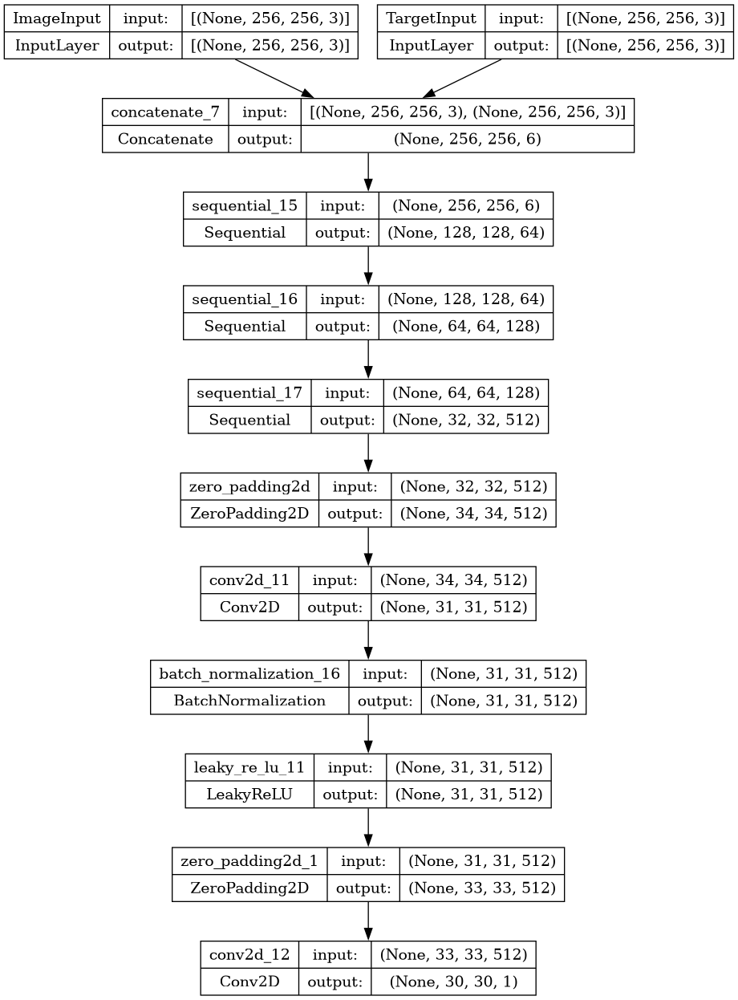

In [13]:
# Plot the architecture of the Discriminator model and save the plot to a file
plot_model(discriminator, "Discriminator.png", show_shapes=True)


In [14]:
# Define a binary cross-entropy loss object for adversarial training
loss_object = BinaryCrossentropy(from_logits=True)

# Define an Adam optimizer for the Generator model
generator_optimizer = Adam(learning_rate=1e-4, beta_1=0.5)

# Define an Adam optimizer for the Discriminator model
discriminator_optimizer = Adam(learning_rate=2e-4, beta_1=0.5)


defining a binary cross-entropy loss object (loss_object) with the from_logits=True argument for adversarial training. Additionally, you are defining separate Adam optimizers (generator_optimizer and discriminator_optimizer) for the Generator and Discriminator models, respectively, with specified learning rates and beta parameter

In [15]:
def gen_loss(disc_gen_generated, gen_out, target_img):
    # Adversarial loss using binary cross-entropy
    gan_loss = loss_object(tf.ones_like(disc_gen_generated), disc_gen_generated)

    # L1 loss measuring the absolute difference between generated and target images
    l1_loss = tf.reduce_mean(tf.abs(target_img - gen_out))

    # Total generator loss, a weighted sum of adversarial and L1 losses
    total_loss = (100 * l1_loss) + gan_loss

    return total_loss, gan_loss, l1_loss


thefunction computes the generator loss, which consists of an adversarial loss (GAN loss) using binary cross-entropy (gan_loss) and an L1 loss measuring the absolute difference between the generated and target images (l1_loss). The total generator loss (total_loss) is a weighted sum of these two

In [16]:
def disc_loss(dis_real_output, disc_gen_output):
    # Adversarial loss for real images
    real_loss = loss_object(tf.ones_like(dis_real_output), dis_real_output)

    # Adversarial loss for generated images
    fake_loss = loss_object(tf.zeros_like(disc_gen_output), disc_gen_output)

    # Total discriminator loss, sum of real and fake losses
    total_loss = real_loss + fake_loss

    return total_loss


the function computes the discriminator loss, which consists of adversarial losses for both real and generated images. The total discriminator loss is the sum of these two losses.

In [17]:
@tf.function()
def train_step(inputs, target):
    # Use GradientTape to record operations for automatic differentiation
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # Generate images using the Generator
        gen_output = generator(inputs, training=True)
        
        # Calculate discriminator outputs for real and generated images
        disc_real_output = discriminator([inputs, target], training=True)
        disc_gen_generated = discriminator([inputs, gen_output], training=True)
        
        # Generator Loss
        gen_total_loss, gen_gan_loss, gen_l1_loss = gen_loss(disc_gen_generated, gen_output, target)
        
        # Discriminator Loss
        Disc_loss = disc_loss(disc_real_output, disc_gen_generated)
    
    # Compute and apply gradients for the Generator
    generator_gradients = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(generator_gradients, generator.trainable_variables))
    
    # Compute and apply gradients for the Discriminator
    discriminator_gradients = disc_tape.gradient(Disc_loss, discriminator.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(discriminator_gradients, discriminator.trainable_variables))


the function represents a training step for the Generative Adversarial Network (GAN). It uses TensorFlow's GradientTape to record operations for automatic differentiation. The Generator generates images, and the Discriminator evaluates real and generated images. The function computes and applies gradients for both the Generator and Discriminator based on the adversarial and L1 losses.

In [18]:
def show_predictions(image, mask):
    # Randomly select an index from the dataset
    id = np.random.randint(len(image))

    # Generate a mask prediction for the selected index
    pred_out = generator.predict(image)[id]

    # Retrieve the ground truth mask and image for the selected index
    mask = mask[id]
    image = image[id]

    # Create a figure with three subplots for original image, original mask, and predicted mask
    plt.figure(figsize=(8, 5))

    # Subplot for the original image
    plt.subplot(1, 3, 1)
    show_image(image, title="Original Image")

    # Subplot for the original mask
    plt.subplot(1, 3, 2)
    show_image(mask, title="Original Mask")

    # Subplot for the predicted mask
    plt.subplot(1, 3, 3)
    show_image(pred_out, title="Predicted Mask")

    # Adjust layout for better visualization
    plt.tight_layout()


the function takes an image and mask, randomly selects an index, generates a mask prediction using the Generator, and then displays the original image, original mask, and predicted mask in a single figure with three subplots. The show_image function is used to display the images.

In [19]:
def show_performance(n_images):
    # Iterate through the first n_images in the dataset
    for image, mask in data.take(n_images):
        # Show predictions for the current image and mask
        show_predictions(image, mask)
        
        # Display the figure
        plt.show()


the function takes the first n_images from the dataset and displays predictions using the show_predictions function for each image and mask pair. The plt.show() statement is used to display the figures.

In [20]:
def fit(epoch=1):
    # Iterate through epochs using tqdm for progress visualization
    for epoch in tqdm(range(epoch)):
        # Iterate through batches of images and targets in the dataset
        for images, targets in data:
            # Perform a training step for the GAN
            train_step(images, targets)


the function trains the Generative Adversarial Network (GAN) for a specified number of epochs. It uses tqdm to display a progress bar for the epochs and iterates through batches of images and targets in the dataset, performing a training step for each batch using the train_step function.

In [21]:
# Convert color and grayscale images to float32
color_images, gray_images = tf.cast(color_images, tf.float32), tf.cast(gray_images, tf.float32)

# Create a dataset by combining grayscale and color images
dataset = (gray_images, color_images)

# Create a TensorFlow dataset from the combined dataset and batch it with a batch size of 32
data = tf.data.Dataset.from_tensor_slices(dataset).batch(32, drop_remainder=True)


converting color and grayscale images to float32, combining them into a dataset, and then creating a TensorFlow dataset from this combined dataset. The resulting dataset is batched with a batch size of 32, and any remaining data is dropped (drop_remainder=True).

100%|██████████| 10/10 [03:24<00:00, 20.48s/it]


1/1 [==============================] - 0s 393ms/step


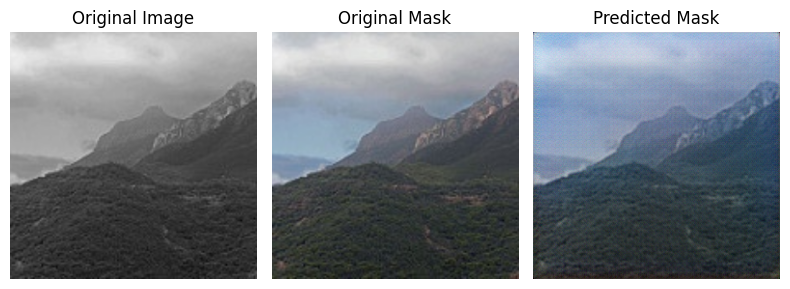

1/1 [==============================] - 0s 31ms/step


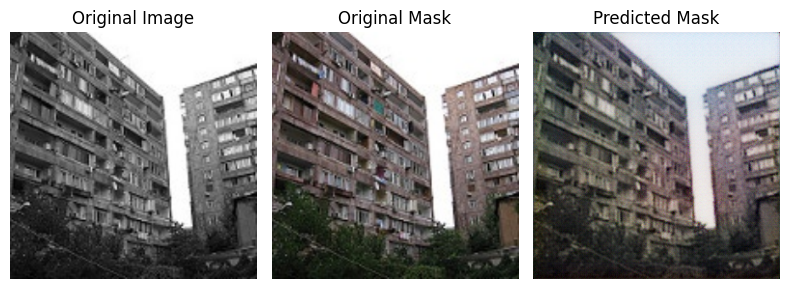

1/1 [==============================] - 0s 30ms/step


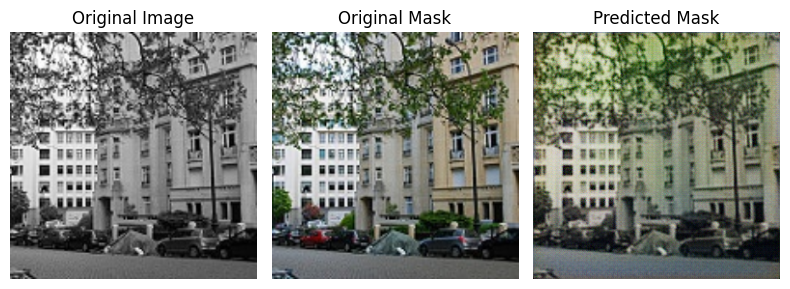

1/1 [==============================] - 0s 45ms/step


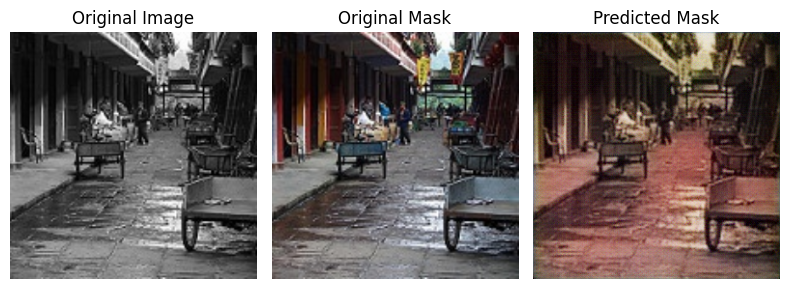

1/1 [==============================] - 0s 45ms/step


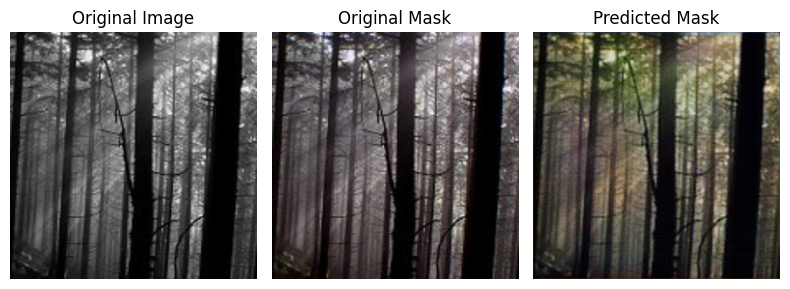

In [22]:
fit(10)
show_performance(5)

100%|██████████| 10/10 [03:01<00:00, 18.13s/it]


1/1 [==============================] - 0s 30ms/step


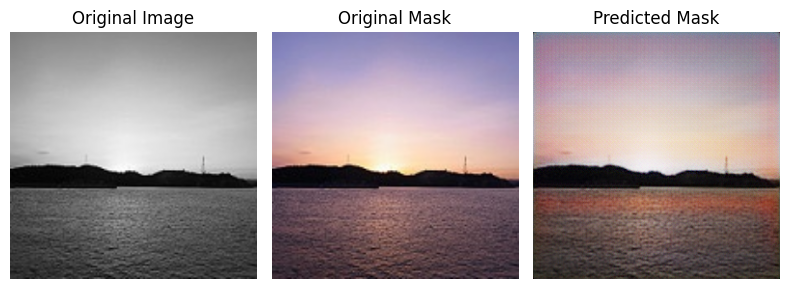

1/1 [==============================] - 0s 49ms/step


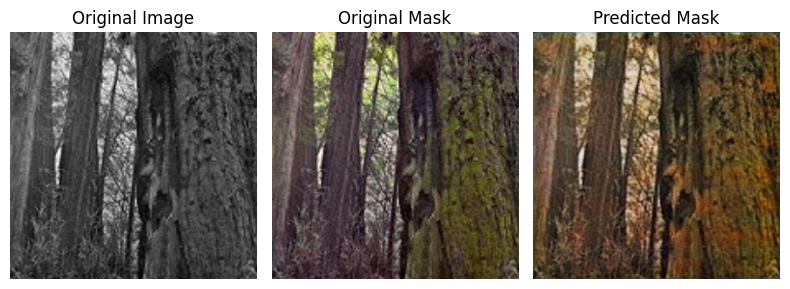

1/1 [==============================] - 0s 29ms/step


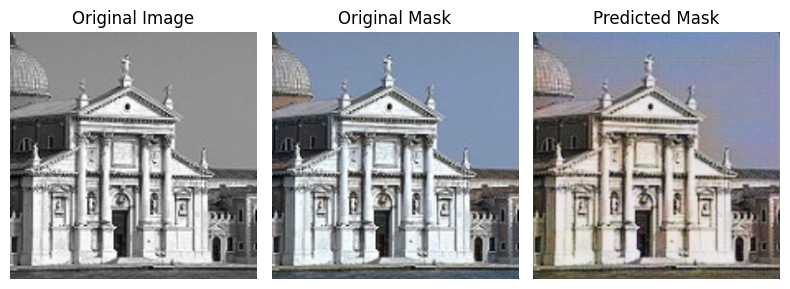

1/1 [==============================] - 0s 32ms/step


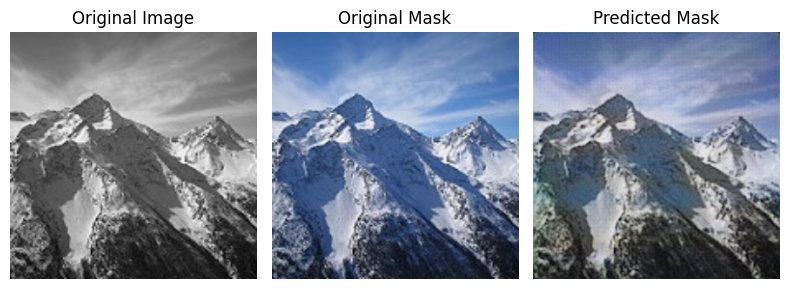

1/1 [==============================] - 0s 44ms/step


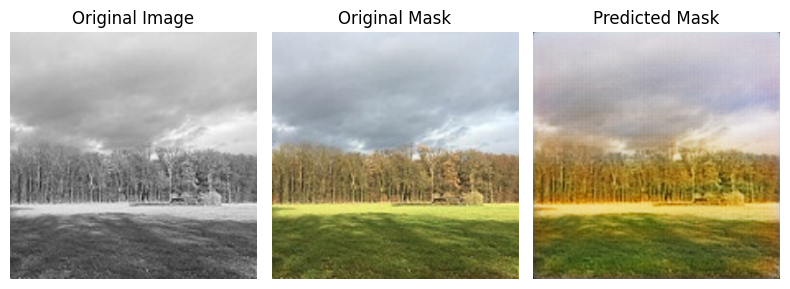

In [23]:
fit(10)
show_performance(5)

100%|██████████| 10/10 [03:01<00:00, 18.13s/it]


1/1 [==============================] - 0s 43ms/step


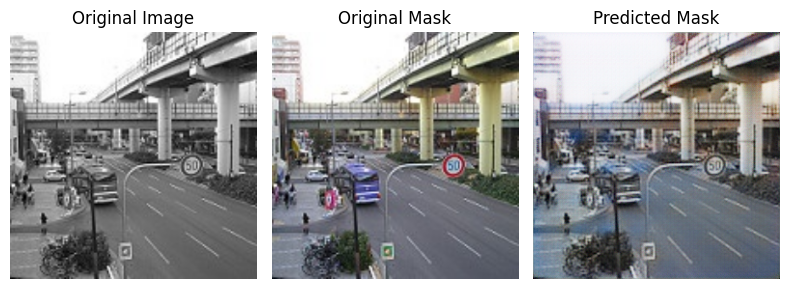

1/1 [==============================] - 0s 42ms/step


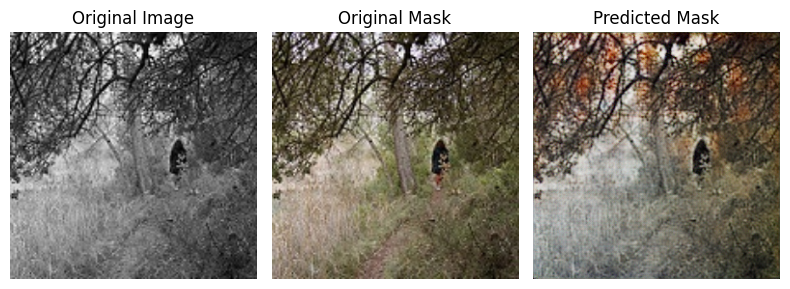

1/1 [==============================] - 0s 30ms/step


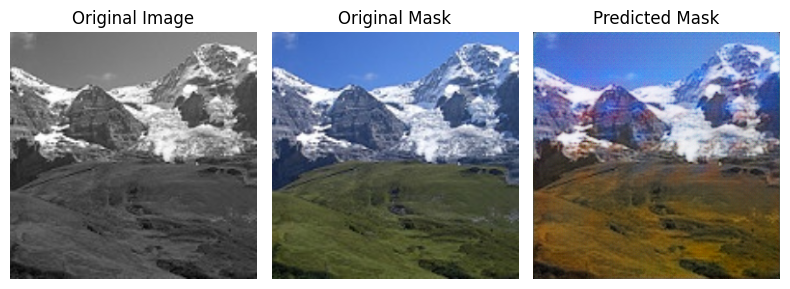

1/1 [==============================] - 0s 29ms/step


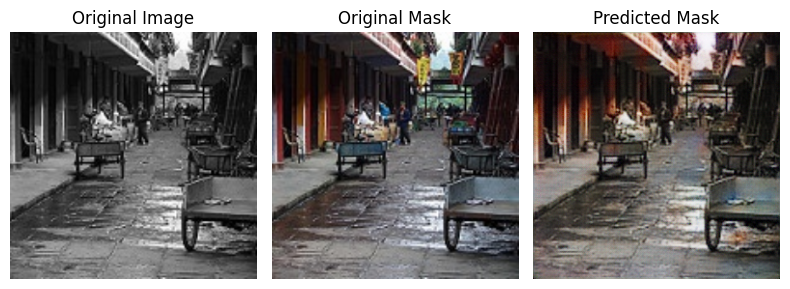

1/1 [==============================] - 0s 30ms/step


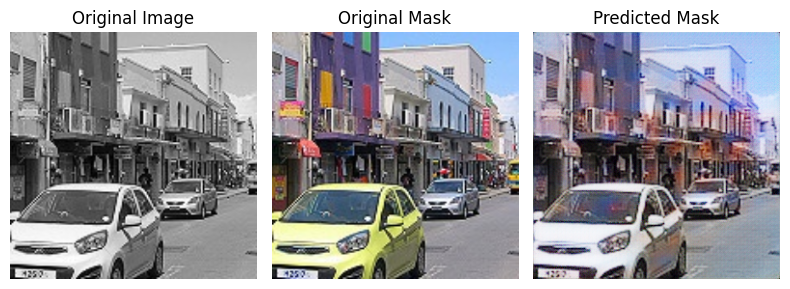

In [24]:
fit(10)
show_performance(5)

100%|██████████| 10/10 [03:01<00:00, 18.13s/it]


1/1 [==============================] - 0s 33ms/step


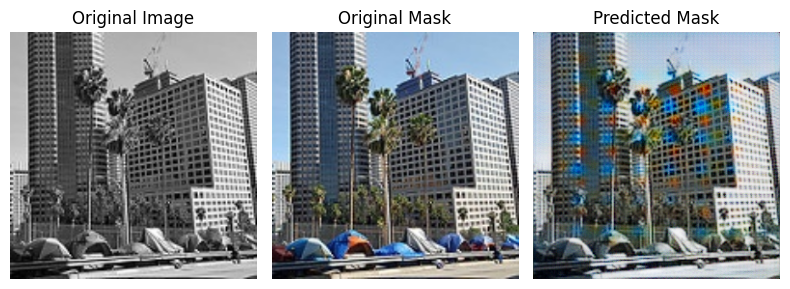

1/1 [==============================] - 0s 32ms/step


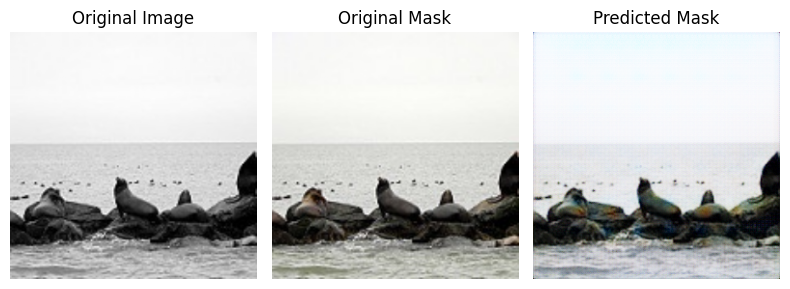

1/1 [==============================] - 0s 30ms/step


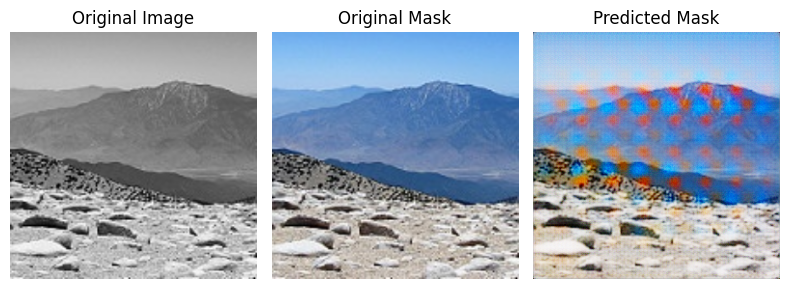

1/1 [==============================] - 0s 29ms/step


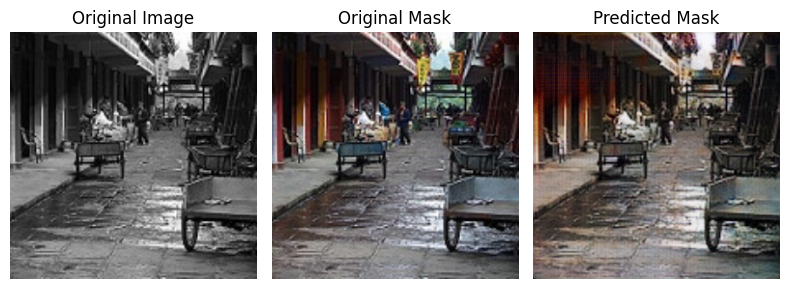

1/1 [==============================] - 0s 30ms/step


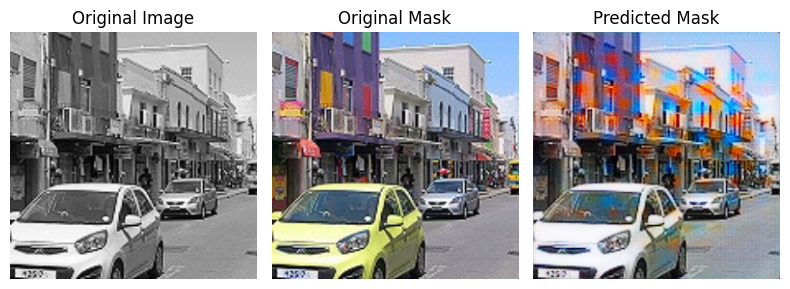

In [25]:
fit(10)
show_performance(5)

100%|██████████| 5/5 [01:30<00:00, 18.07s/it]


1/1 [==============================] - 0s 32ms/step


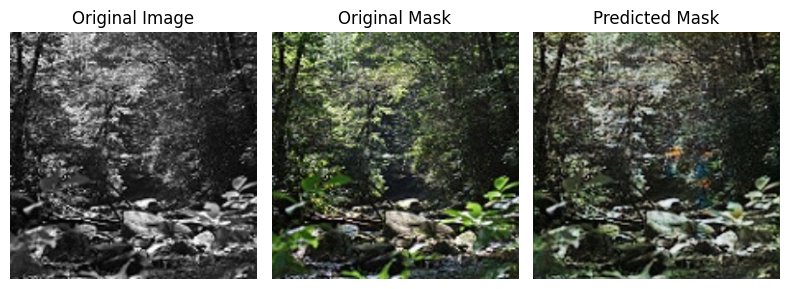

1/1 [==============================] - 0s 34ms/step


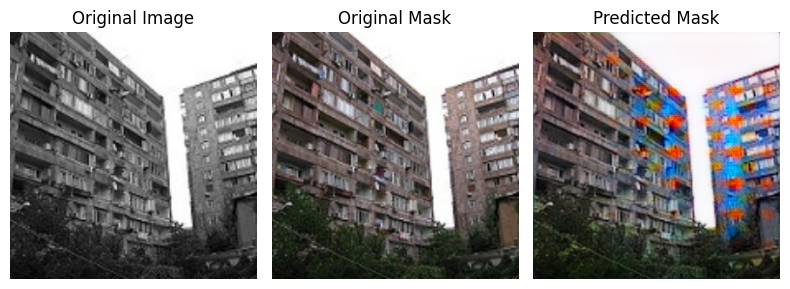

1/1 [==============================] - 0s 33ms/step


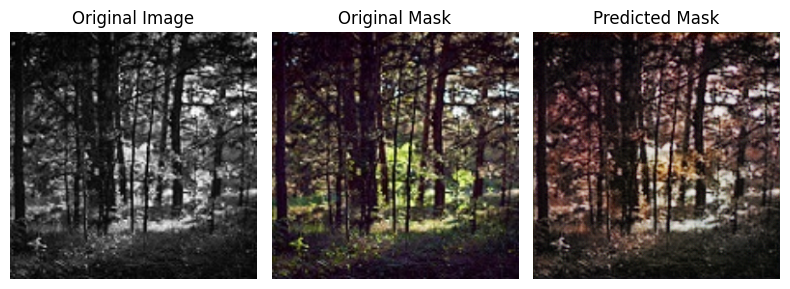

1/1 [==============================] - 0s 33ms/step


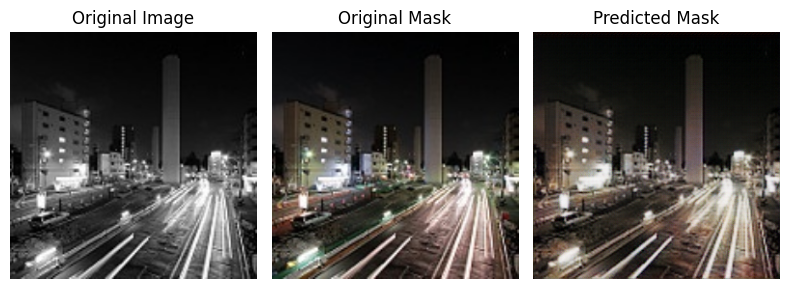

1/1 [==============================] - 0s 34ms/step


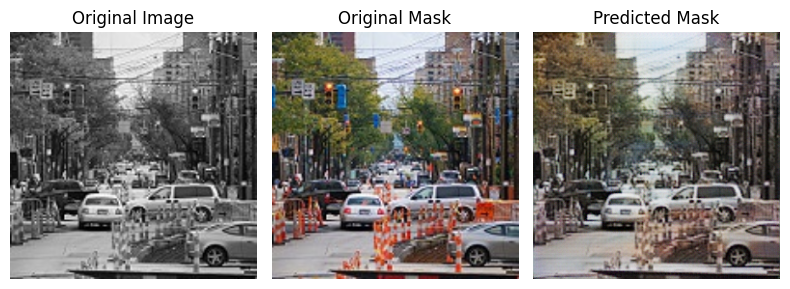

1/1 [==============================] - 0s 33ms/step


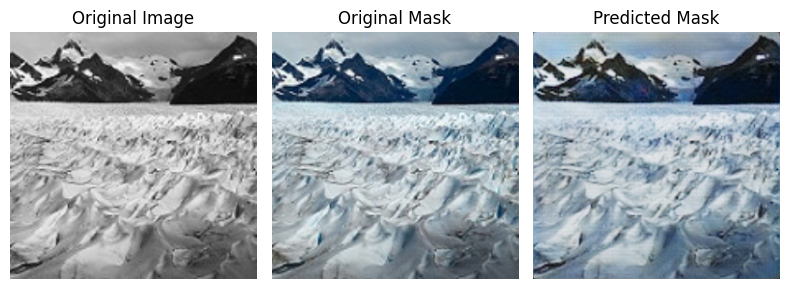

1/1 [==============================] - 0s 30ms/step


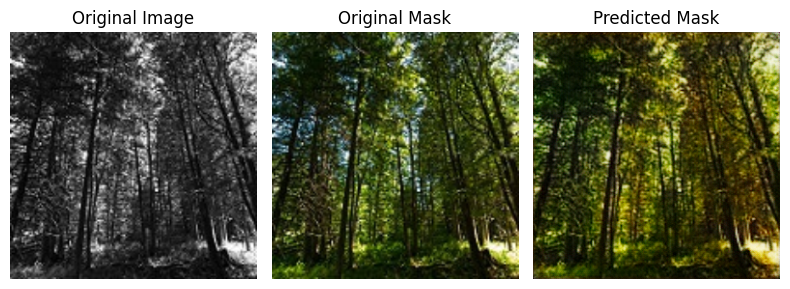

1/1 [==============================] - 0s 31ms/step


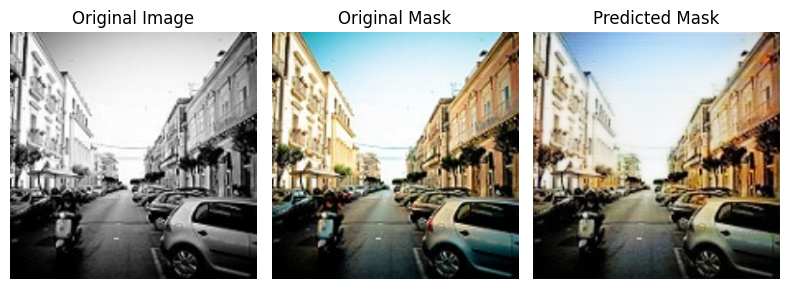

1/1 [==============================] - 0s 30ms/step


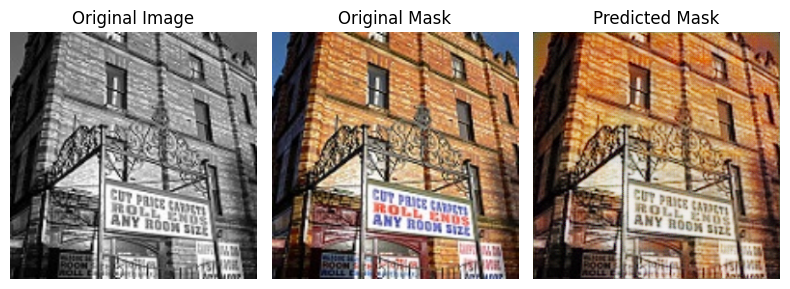

1/1 [==============================] - 0s 31ms/step


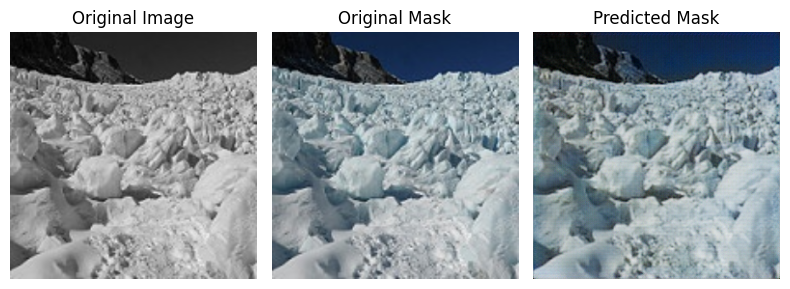

In [26]:
fit(5)
show_performance(10)

100%|██████████| 5/5 [01:30<00:00, 18.07s/it]


1/1 [==============================] - 0s 32ms/step


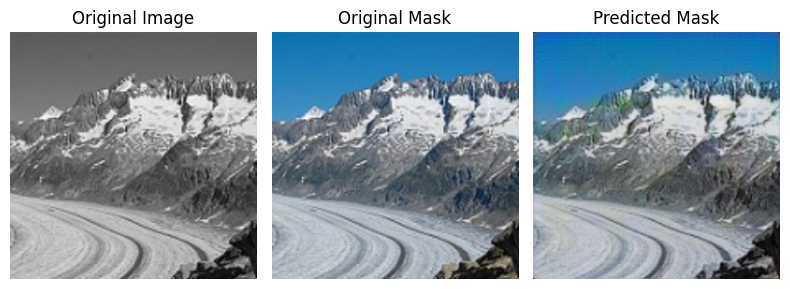

1/1 [==============================] - 0s 32ms/step


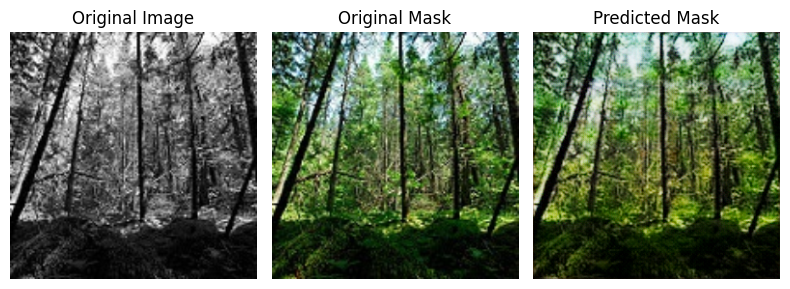

1/1 [==============================] - 0s 38ms/step


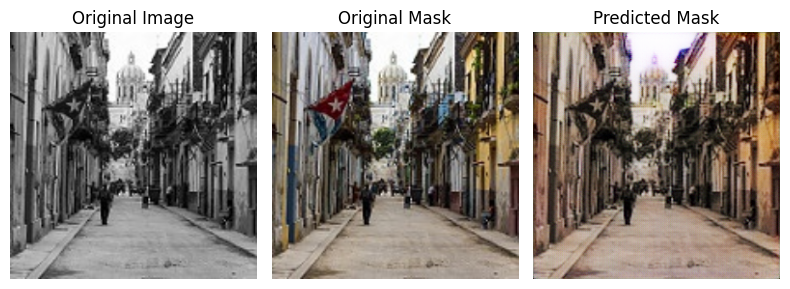

1/1 [==============================] - 0s 34ms/step


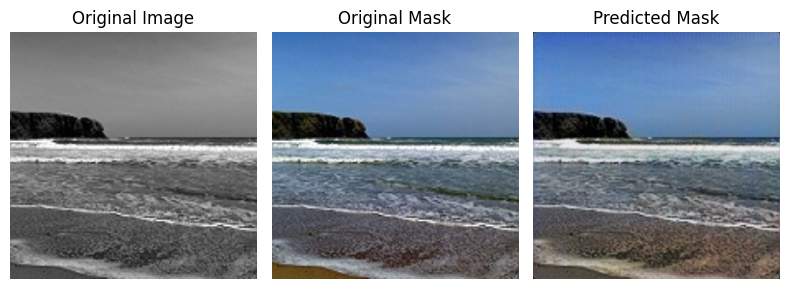

1/1 [==============================] - 0s 49ms/step


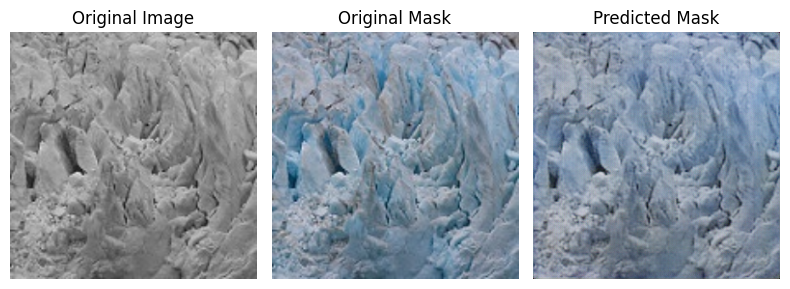

1/1 [==============================] - 0s 30ms/step


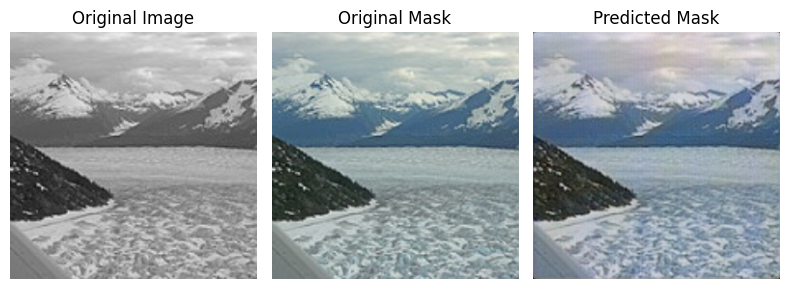

1/1 [==============================] - 0s 31ms/step


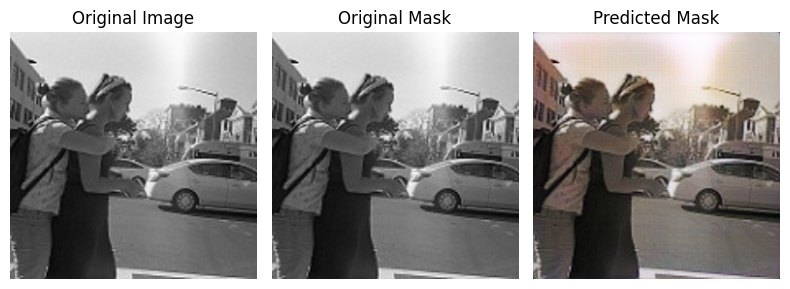

1/1 [==============================] - 0s 44ms/step


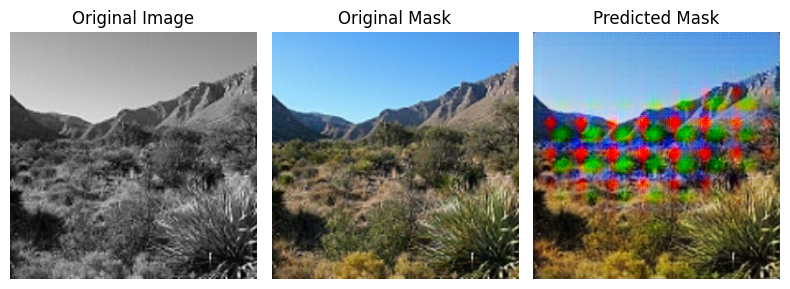

1/1 [==============================] - 0s 31ms/step


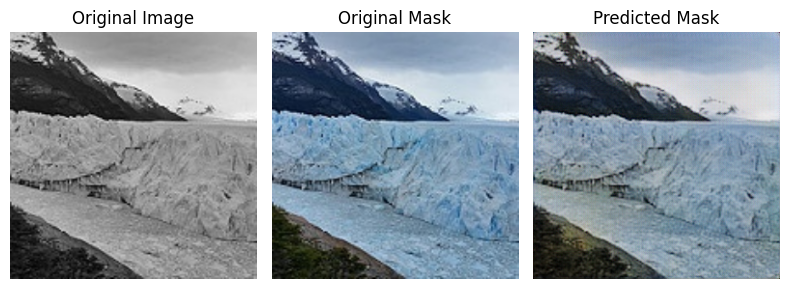

1/1 [==============================] - 0s 31ms/step


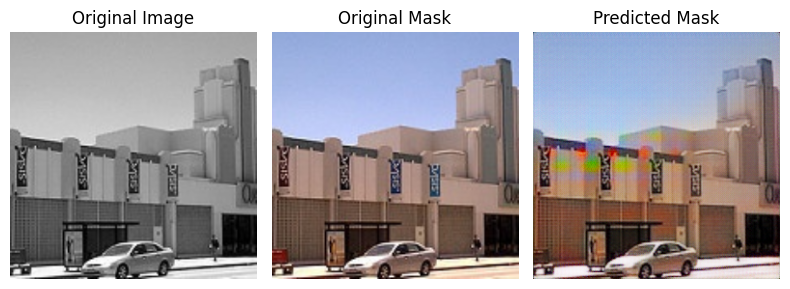

In [27]:
fit(5)
show_performance(10)

100%|██████████| 5/5 [01:30<00:00, 18.08s/it]


1/1 [==============================] - 0s 34ms/step


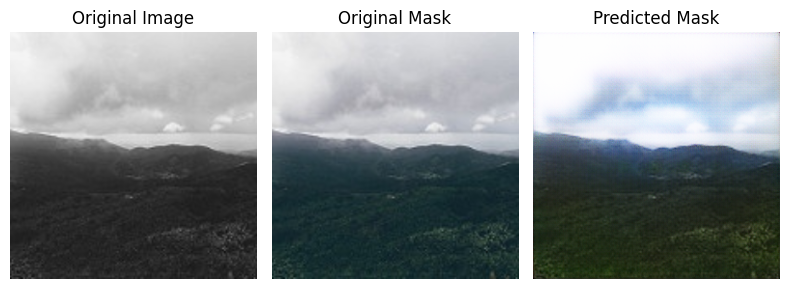

1/1 [==============================] - 0s 36ms/step


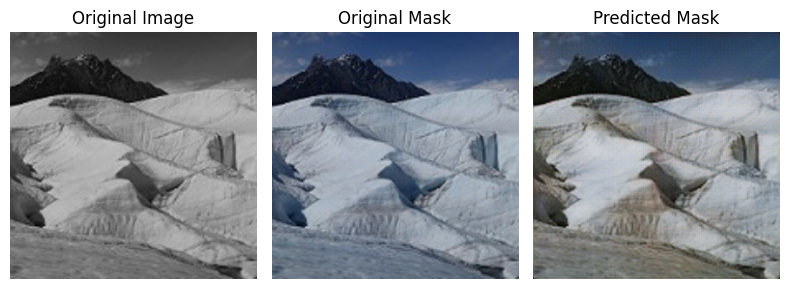

1/1 [==============================] - 0s 33ms/step


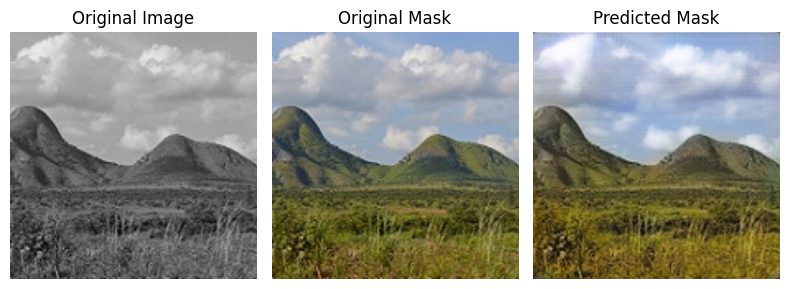

1/1 [==============================] - 0s 33ms/step


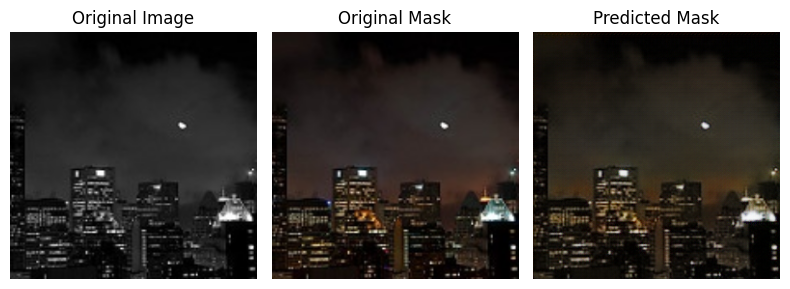

1/1 [==============================] - 0s 31ms/step


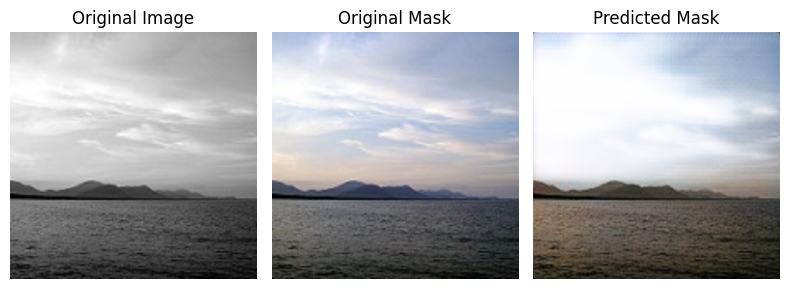

1/1 [==============================] - 0s 30ms/step


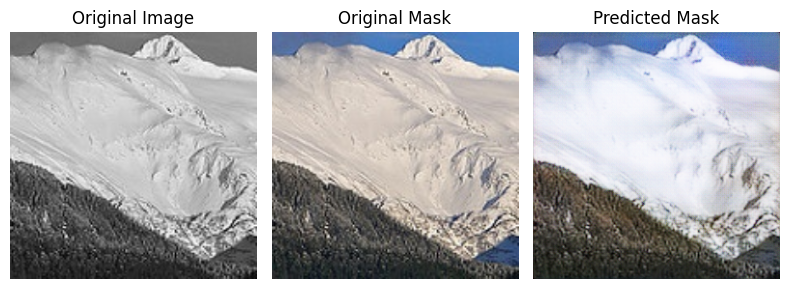

1/1 [==============================] - 0s 30ms/step


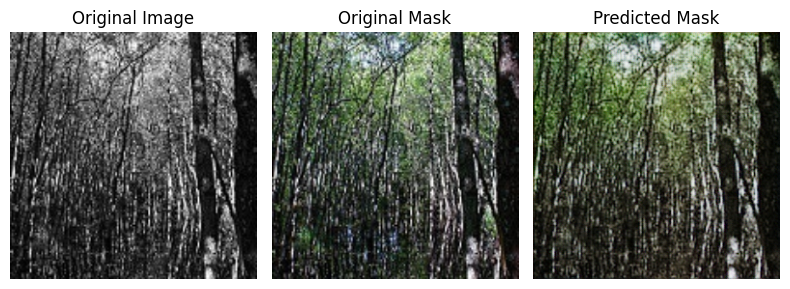

1/1 [==============================] - 0s 30ms/step


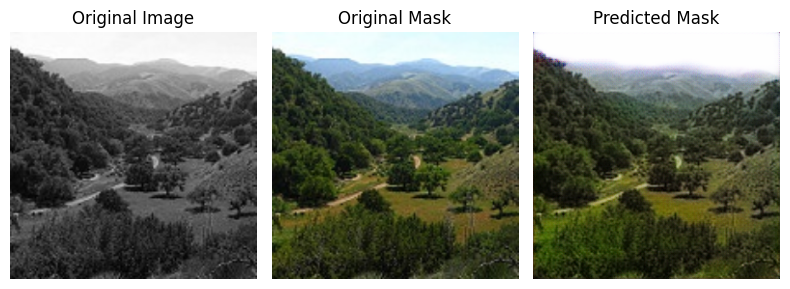

1/1 [==============================] - 0s 31ms/step


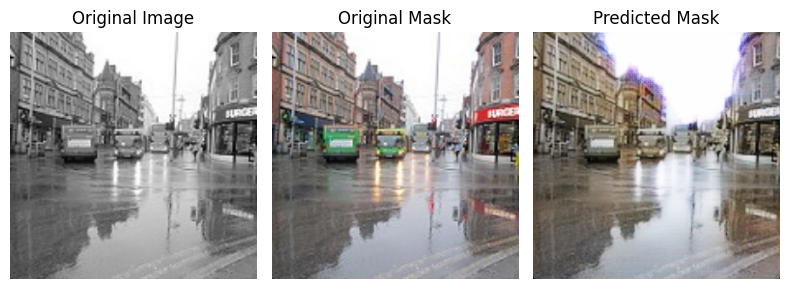

1/1 [==============================] - 0s 34ms/step


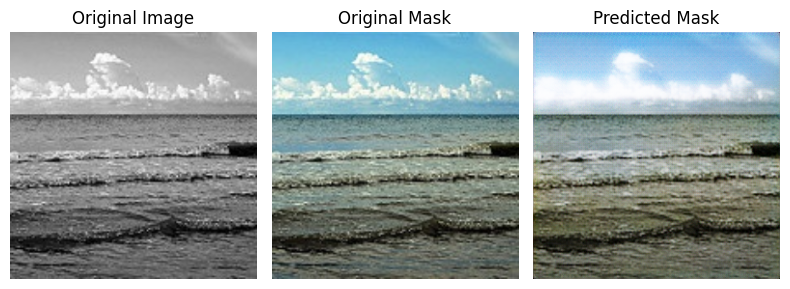

In [28]:
fit(5)
show_performance(10)

In [29]:
generator.save('generator_best.h5')
discriminator.save('discriminator_best.h5')
generator.save('generator_best.keras')
discriminator.save('discriminator_best.keras')

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [30]:
def load_data(path1,path2, trim=1000):
    # Get a list of paths for color images and limit the number using the trim parameter
    color_paths = sorted(glob(path1 + "*.JPG"))[:trim]
    
    # Initialize an empty list to store paths for corresponding grayscale images
    gray_paths = sorted(glob(path2 + "*.jpg"))[:trim]
    
    
    
    # Initialize arrays to store color and grayscale images with shape (num_images, 256, 256, 3)
    images = np.zeros(shape=(len(color_paths), 256, 256, 3))
    masks = np.zeros(shape=(len(gray_paths), 256, 256, 3))
    
    # Initialize a counter variable
    i = 0
    
    # Loop through pairs of color and grayscale paths, loading and processing images
    for color_path, gray_path in tqdm(zip(color_paths, gray_paths), desc="Test_Data"):
        # Load color image, cast to float32, and store in the 'images' array
        image = tf.cast(img_to_array(load_img(color_path)), tf.float32)
        images[i] = (tfi.resize(image, (256, 256))) / 255.
        
        # Load grayscale image, cast to float32, and store in the 'masks' array
        mask = tf.cast(img_to_array(load_img(gray_path)), tf.float32)
        masks[i] = (tfi.resize(mask, (256, 256))) / 255.

        # Increment the counter
        i += 1
    
    # Return the loaded and processed color and grayscale images
    return images, masks


In [31]:
# Define the path to the color images directory
path1 = '/kaggle/input/custom-data/color/'
path2 = '/kaggle/input/custom-data/bw/'


# Call the load_data function to load and preprocess color and grayscale images
t_color_images, t_gray_images = load_data(path1,path2)


Test_Data: 1it [00:00,  1.20it/s]


In [32]:
def show_image(image, title=None, alpha=1.0):
    # Display the image using Matplotlib
    plt.imshow(image, alpha=alpha)
    
    # Set the title if provided
    if title is not None:
        plt.title(title)
    
    # Turn off axis labels
    plt.axis('off')

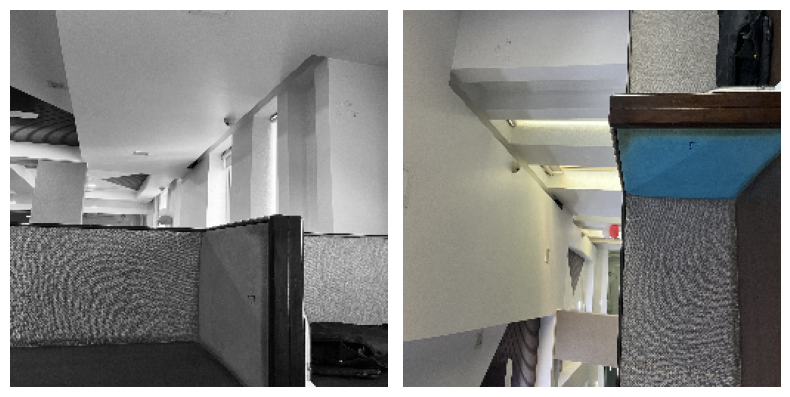

In [33]:
# Create a figure with a specified size
plt.figure(figsize=(8, 15))

# Initialize a counter variable
n = 0

# Loop through 10 iterations to display 5 pairs of color and grayscale images
for i in range(2):
    # Create subplots in a 1x2 grid
    plt.subplot(1, 2, i + 1)
    
    # Alternate between displaying grayscale and color images
    if n == 0:
        # Display grayscale image
        color, gray = t_color_images[i], t_gray_images[i]
        show_image(gray)
        n += 1
    elif n == 1:
        # Display color image
        show_image(color)
        n = 0

# Adjust layout for better visualization
plt.tight_layout()

# Show the plot
plt.show()

1/1 [==============================] - 1s 574ms/step


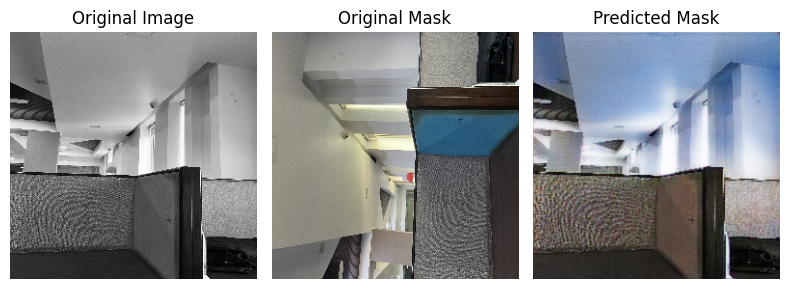

In [34]:
# Generate a mask prediction for the selected index
pred_out = generator.predict(t_gray_images)[0]

# Retrieve the ground truth mask and image for the selected index
mask = t_color_images[0]
image = t_gray_images[0]

# Create a figure with three subplots for original image, original mask, and predicted mask
plt.figure(figsize=(8, 5))

# Subplot for the original image
plt.subplot(1, 3, 1)
show_image(image, title="Original Image")

# Subplot for the original mask
plt.subplot(1, 3, 2)
show_image(mask, title="Original Mask")

# Subplot for the predicted mask
plt.subplot(1, 3, 3)
show_image(pred_out, title="Predicted Mask")

# Adjust layout for better visualization
plt.tight_layout()